In [1]:
import os
import sys
sys.path.append('/scratch_tmp/users/k21066795/NBT-phenotyping')
import scanpy as sc
import anndata
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from utils_pheno import *

In [ ]:
model_stains = ['gigapath_aug', 'UNI_aug', 'iBOT_aug', 'EXAONEPath_aug', 'conch_rein', 'gigapath_rein', 'UNI_rein', 
                'iBOT_rein', 'EXAONEPath_rein', 'conch_orig', 'UNI_orig', 'gigapath_orig', 'iBOT_orig', 'EXAONEPath_orig']
resolution=0.5

for model_stain in model_stains:
    knn_df = get_KNN_data(model_stain)
    run_KNN(knn_df, save_pt=None)
    adata = get_adata(knn_df)
    adata = run_leiden_umap(adata, resolution=resolution)
    adata.write(f'/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/adata/adata_{model_stain}_resolution{resolution}.h5ad')

In [50]:
folder = '/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/KNN_probe'
df_all = pd.DataFrame()
for i in os.listdir(folder):
    if '.csv' in i:
        file = os.path.join(folder, i)  # Use os.path.join for better compatibility
        df = pd.read_csv(file)  # Read each CSV file
        model_stain = f"{i.split('_')[2]}_{i.split('_')[3]}"
        df['model_stain'] = model_stain
        df_all = pd.concat([df_all, df], ignore_index=True)  # Concatenate and reset index
df_all['mean_test_score'] = df_all[['split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score']].mean(axis=1)
df_all['model'] = [i.split('_')[0] for i in list(df_all['model_stain'])]
df_all['stain'] = [i.split('_')[1] for i in list(df_all['model_stain'])]
df_all

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,n_neighbors,model_stain,model,stain
0,0.371883,0.017914,52.819881,0.129404,8,0.812472,0.810593,0.811588,0.811533,0.809642,0.811166,0.000966,1,8,iBOT_aug,iBOT,aug
1,0.379817,0.003139,52.949021,0.007955,16,0.808437,0.809100,0.811588,0.809708,0.808592,0.809485,0.001142,2,16,iBOT_aug,iBOT,aug
2,0.382608,0.004992,52.997364,0.123469,32,0.799591,0.801636,0.801249,0.798651,0.798142,0.799854,0.001384,3,32,iBOT_aug,iBOT,aug
3,0.382434,0.002255,53.419581,0.007126,64,0.788092,0.791298,0.790966,0.785106,0.784376,0.787968,0.002870,4,64,iBOT_aug,iBOT,aug
4,0.383560,0.003505,54.050400,0.008212,128,0.772722,0.773883,0.774934,0.769847,0.770111,0.772300,0.002021,5,128,iBOT_aug,iBOT,aug
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100,0.469319,0.011460,19.652419,1.500368,32,0.932992,0.928697,0.926880,0.927427,0.928803,0.928960,0.002146,3,32,iBOT_orig,iBOT,orig
101,0.497222,0.063397,21.507993,2.688995,64,0.912014,0.905902,0.906068,0.907494,0.908595,0.908015,0.002230,4,64,iBOT_orig,iBOT,orig
102,0.515992,0.075280,20.861882,0.543615,128,0.888559,0.883328,0.884099,0.885854,0.879963,0.884360,0.002840,5,128,iBOT_orig,iBOT,orig
103,0.510065,0.067707,19.369784,1.706727,256,0.862075,0.856073,0.858716,0.858543,0.849788,0.857039,0.004097,6,256,iBOT_orig,iBOT,orig


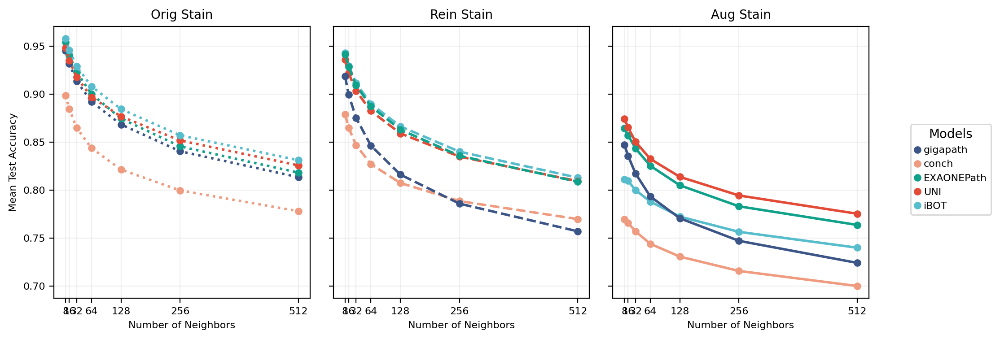

In [56]:
knn_acc_lineplot(df_all)

/tmp/ipykernel_46306/3473789691.py:25: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(model_order, rotation=45, fontsize=8)
/tmp/ipykernel_46306/3473789691.py:25: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(model_order, rotation=45, fontsize=8)
/tmp/ipykernel_46306/3473789691.py:25: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(model_order, rotation=45, fontsize=8)


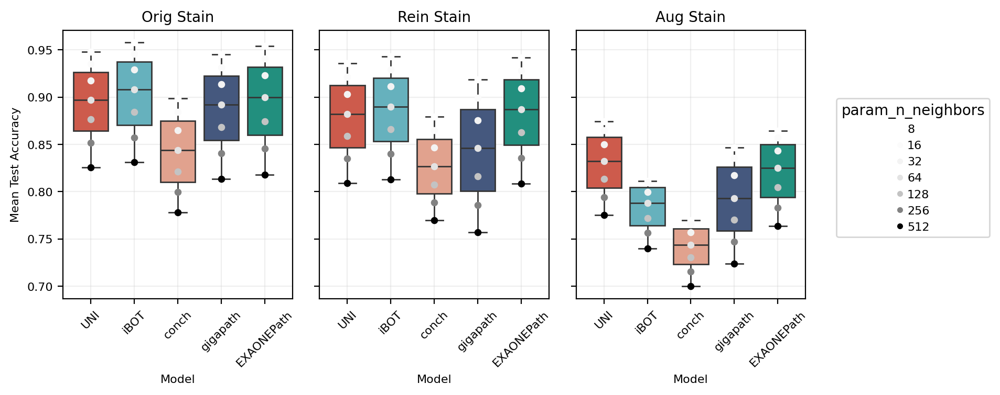

In [64]:
knn_acc_boxplot(df_all)

In [4]:
sc.set_figure_params(scanpy=True, dpi=100)
sc.settings.figdir = '/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/'

model_stain='UNI_aug'
resolution=0.5
groupby = f"leiden_{resolution}"
file_path = f'/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/adata/adata_UNI_aug_clean.h5ad'
adata = sc.read_h5ad(file_path)

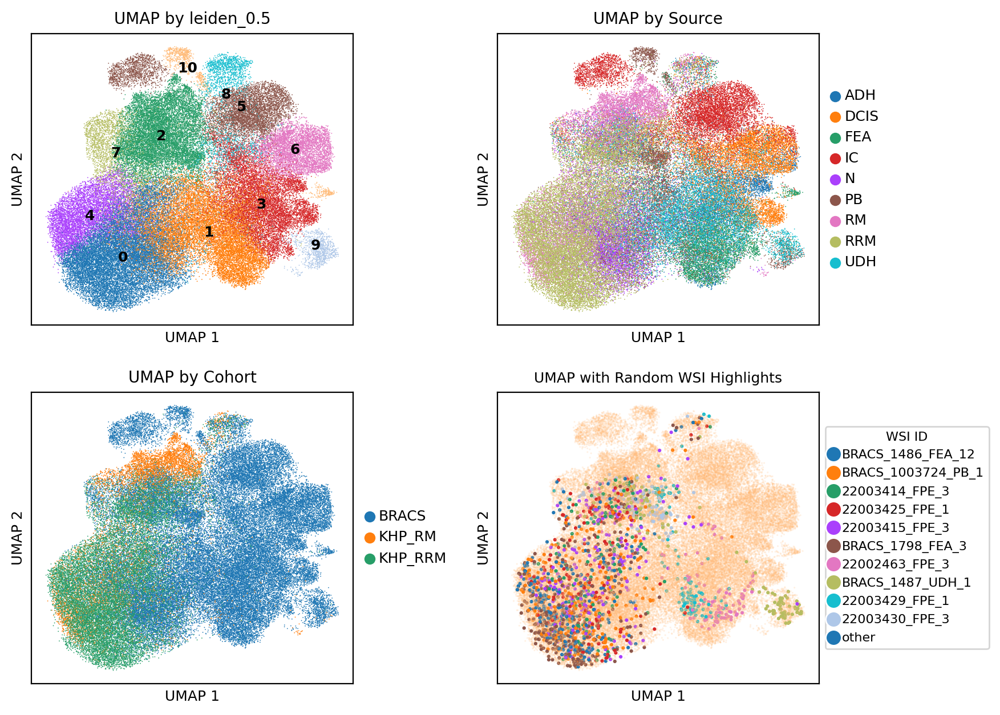

In [34]:
fig, axes = plt.subplots(2, 2, figsize=(9, 6.5))

sc.pl.umap(adata, color=groupby, legend_fontsize=9, legend_loc='on data', ax=axes[0, 0], show=False)
axes[0, 0].set_title(f'UMAP by {groupby}', fontsize=10)
axes[0, 0].set_xlabel("UMAP 1", fontsize=9)
axes[0, 0].set_ylabel("UMAP 2", fontsize=9)

sc.pl.umap(adata, color="source", legend_fontsize=9, ax=axes[0, 1], show=False)
axes[0, 1].set_title('UMAP by Source', fontsize=10)
axes[0, 1].set_xlabel("UMAP 1", fontsize=9)
axes[0, 1].set_ylabel("UMAP 2", fontsize=9)

sc.pl.umap(adata, color="cohort", legend_fontsize=9, ax=axes[1, 0], show=False)
axes[1, 0].set_title('UMAP by Cohort', fontsize=10)
axes[1, 0].set_xlabel("UMAP 1", fontsize=9)
axes[1, 0].set_ylabel("UMAP 2", fontsize=9)

plot_umap_with_random_wsi(adata, n_iterations=10, fontsize=8, ax=axes[1, 1])
axes[1, 1].set_title('UMAP with Random WSI Highlights', fontsize=9)
axes[1, 1].set_xlabel("UMAP 1", fontsize=9)
axes[1, 1].set_ylabel("UMAP 2", fontsize=9)

plt.tight_layout()
# plt.savefig(f'/scratch_tmp/{model_stain}_umap_comparison.pdf', dpi=300, bbox_inches='tight')
plt.show()

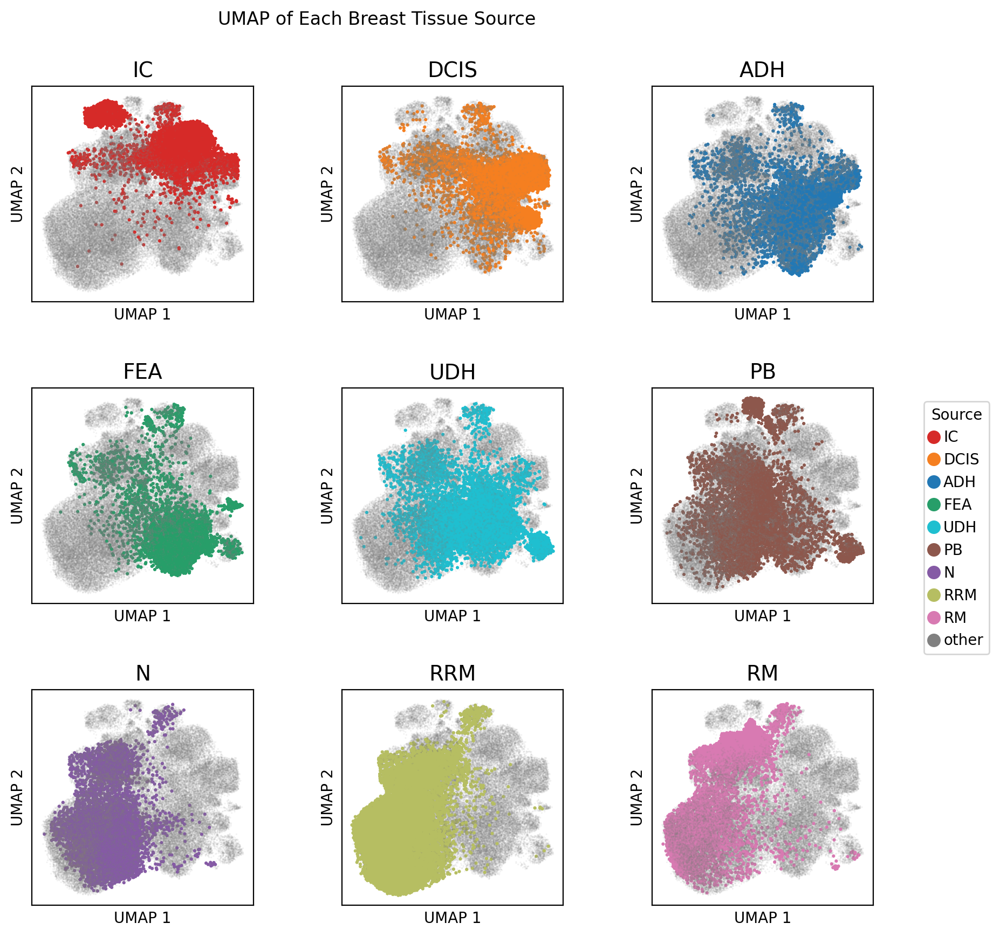

In [44]:
orders = ['IC', 'DCIS', 'ADH', 'FEA', 'UDH', 'PB', 'N', 'RRM', 'RM']
colors = {'IC': '#D62A28', 'DCIS': '#F57F20', 'ADH': '#2278B5', 'FEA': '#279E69', 'UDH': '#1FBFD0', 'PB': '#8D574C', 'N': '#855AA5', 'RM': '#D87AB2', 'RRM': '#B6BE62', 'other': 'gray'}
# save_pt = f'/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/umap/Umap_eachTissue_{model_stain}_{groupby}_clean.png'
plot_umap_highlight_each_source(adata, max_size=20, min_size=1, grid_size=[3,3], figsize=(10, 10), fontsize=12, orders=orders, colors=colors, save_pt=None)

/scratch_tmp/users/k21066795/NBT-phenotyper/utils_pheno.py:433: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  


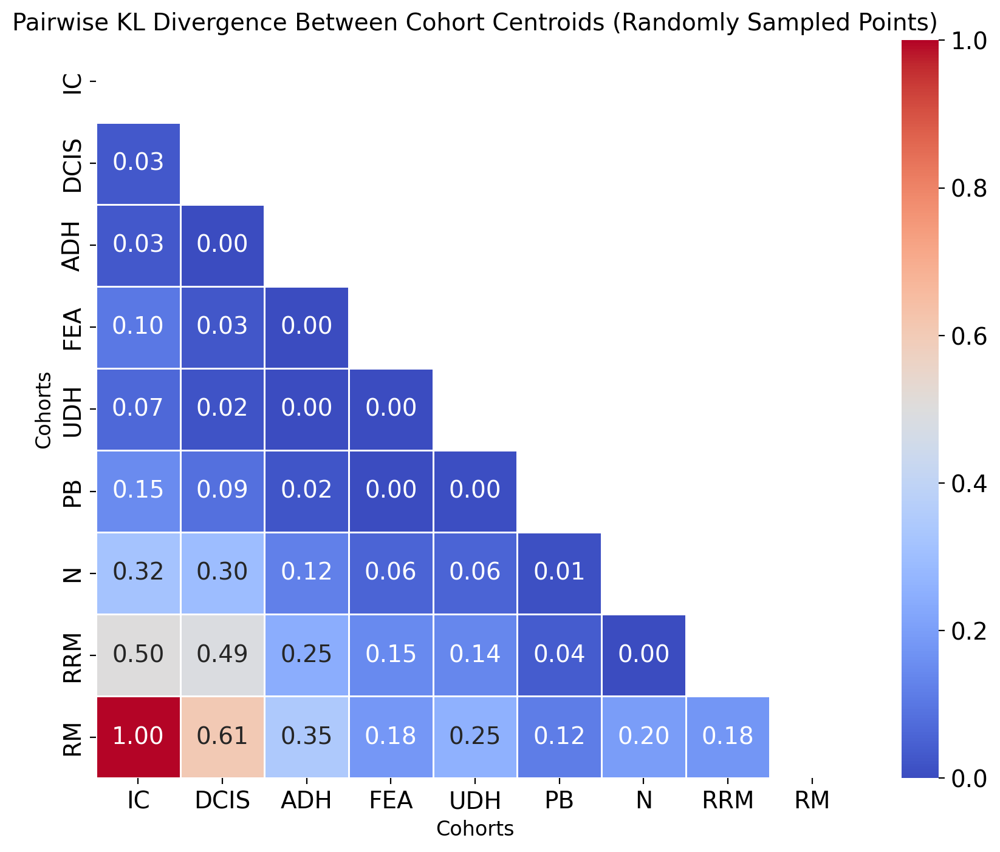

In [13]:
# save_pt = f'/scratch_tmp/prj/cb_normalbreast/prj_NBTPhenotyping/RESULTS/heatmap/{model_stain}_heatmap_kld.pdf'
plot_kl_divergence_heatmap(adata, normalization='minmax', save_pt=None)

In [47]:
groupby = "leiden_0.5"
adata.obs.index = adata.obs['patch_id']
adata = calculate_top_samples(adata, groupby, top_n=50)

Top 50 central samples indices: Index(['BRACS_1319_N_5_256_2304', 'BRACS_1506_N_7_1024_768',
       'BRACS_1326_N_7_1792_1024', 'BRACS_1320_PB_11_1792_1536',
       'BRACS_291_N_13_1280_1024', 'BRACS_1603_PB_12_2048_2048',
       'BRACS_745_N_6_768_3584', 'BRACS_1498_UDH_3_1024_0',
       'BRACS_1235_N_8_512_2048', 'BRACS_1326_UDH_4_768_0',
       ...
       '22002138_FPE_2_72130_17118_23651_26546_136_57_578',
       'BRACS_1830_FEA_6_0_768', 'BRACS_1251_PB_4_1536_1024',
       'BRACS_1830_FEA_4_512_256', 'BRACS_1240_PB_11_2048_2560',
       'BRACS_1830_FEA_8_0_0', 'BRACS_1827_DCIS_1_1280_1792',
       'BRACS_1812_ADH_7_2816_3584', 'BRACS_1240_PB_11_1792_512',
       'BRACS_1831_FEA_2_256_256'],
      dtype='object', name='patch_id', length=550)


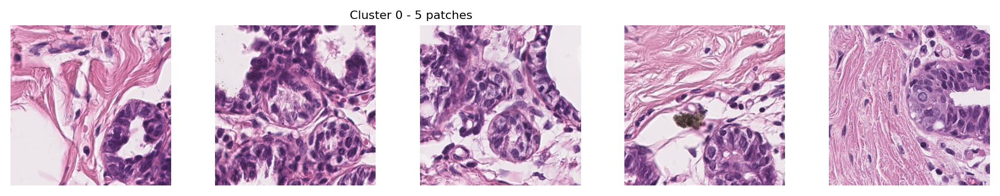

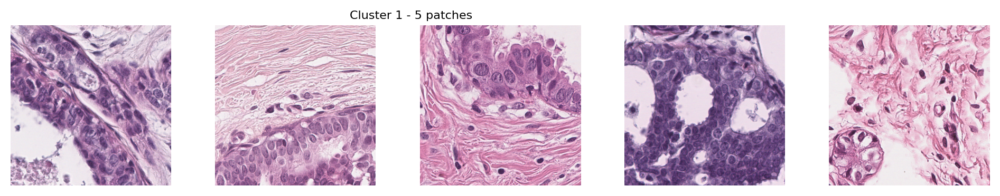

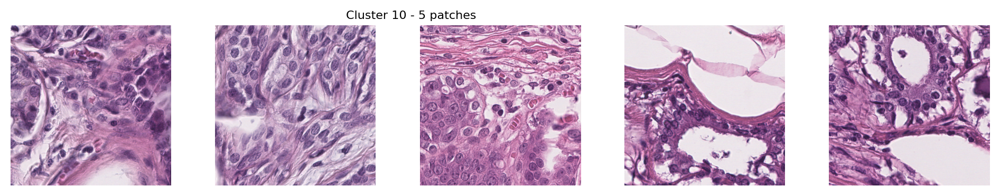

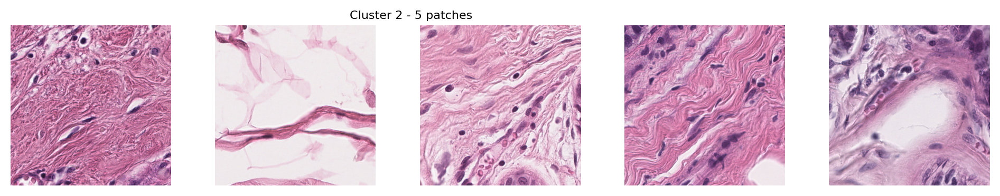

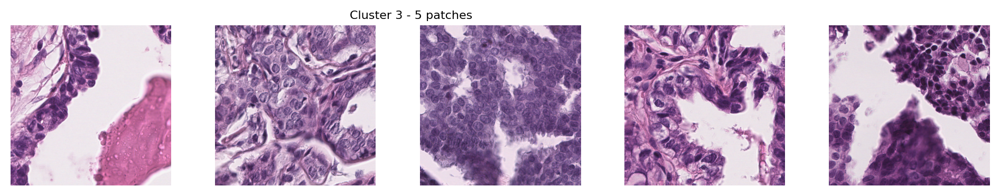

...

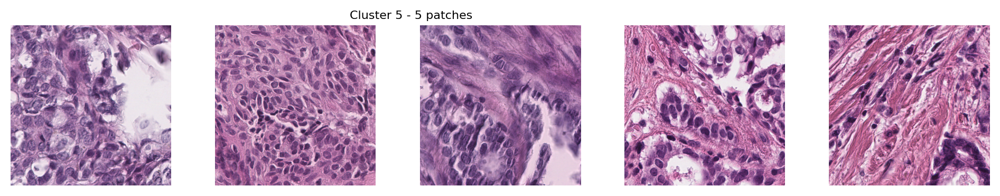

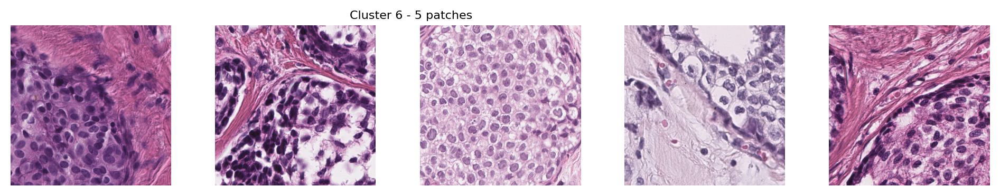

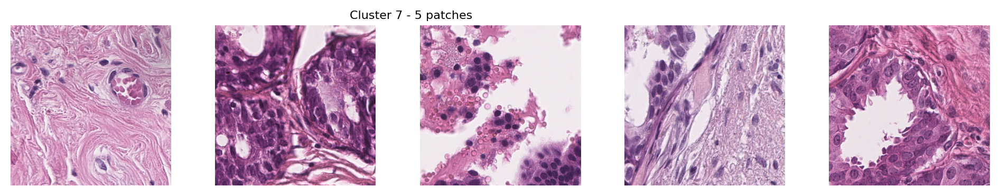

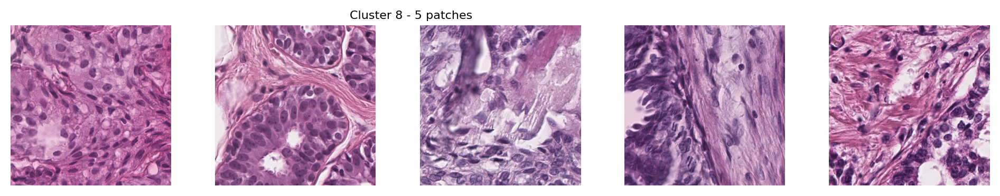

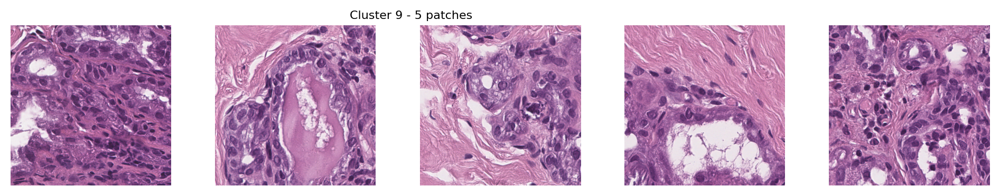

In [75]:
for i, cluster_id in enumerate(np.unique(adata.obs[groupby])):
    plot_cluster_examples(adata, groupby, cluster_id, sampled_number=5, grid_size=[1, 5], figsize=(12, 2), fontsize=8, save_dir=None, save_patches=False)

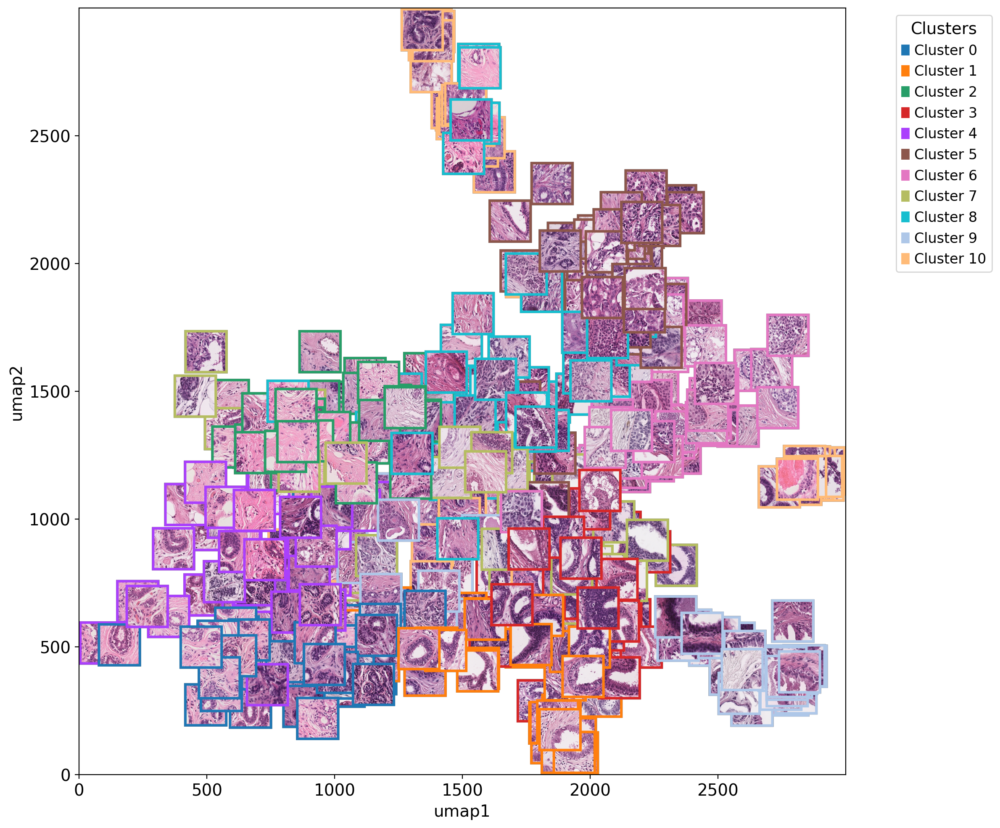

In [77]:
full_img = tsne_HE_overlay(adata, groupby='leiden_0.5', image_size=(3000, 3000), max_dim=150, save_pt=None)